# Instruções da prova

- O único material que poderá ser consultado é este notebook, consultas à outros materiais ou à internet será considerado cola
- Renomear o notebook para C209-PV1.1-NOME_SOBRENOME_MATRICULA
- Enviar no teams a pasta com todas as mídias zipada com o nome "NOME_SOBRENOME_MATRICULA.zip"

# Parte teórica

Classifique as afirmações em Verdadeiro ou Falso, justifique as afirmativas falsas

1 - A etapa de **quantização** em um processo de compressão de dados consiste em aumentar a aleatoriedade das informações.

In [ ]:
# Falso, a quantização iminui a aleatoriedade das informações.

2 - Compresão do tipo fractal consiste em encontrar áreas similares ao redor de uma região de domínio.

In [ ]:
# Verdadeiro.

3 - Histogramas de duas imagens distintas não serão nunca iguais

In [ ]:
# Falso, pois é possível que os histogramas sejam iguais se as duas imagens tiverem a mesma quantidade de pixels da mesma cor.

4 - O método RLE de compressão de dados sempre gera um resultado com menor quantidade de dados (comprimido).

In [ ]:
# Falso, pois o RLE pode gerar um resultado maior que o original se não tiver grande quantidade de dados iguais em sequencia.

5 - No contexto de áudios, frequência de amostragem é a frequência com que são captadas amostras do audio analógico para gerar um digital.

In [ ]:
# Verdadeiro.

# Parte prática

## Material de apoio

### Importações

```
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt
```

### Histograma
```
def histogram_gray(img):
    (l, c) = img.shape
    # Histograma com 1 linha e 256 colunas, preenchido com 0.
    histogram = np.zeros(256, dtype=np.int32)

    for i in range(l):
        for j in range(c):
            # Normalizar intensidade do pixel 
            intensity = img[i, j]
            # Incrementar de 1 a quantidade de pixels no histograma,
            # utilizando a intensidade como índice.
            histogram[intensity] += 1
            
    return histogram

def show_histogram(img):
    histogram_r = histogram_gray(img[:, :, 0])
    histogram_g = histogram_gray(img[:, :, 1])
    histogram_b = histogram_gray(img[:, :, 2])
    
    plt.figure(figsize=(16, 16))
    plt.subplot(2, 1, 1)
    plt.bar(range(256), histogram_r, color='red')
    plt.bar(range(256), histogram_g, color='green')
    plt.bar(range(256), histogram_b, color='blue')

```

### Manipulação de imagens

```
(l,c,p) = img.shape
plt.imshow(imagem)
```

### Forçando uma imagem de uma página para 3 páginas
```
  imagem_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
  imagem_3p[:,:, 0] = frame_1p
  imagem_3p[:,:, 1] = frame_1p
  imagem_3p[:,:, 2] = frame_1p
```

### Detecção de bordas
```
    imagem_grey = np.average(frame, axis=2).astype(np.float64)
   
    abs_tg_c = np.abs(np.diff(imagem_grey.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(imagem_grey.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    imagem_border = np.zeros(shape=(l, c), dtype=np.uint8)
    imagem_border[abs_tg > threshold] = 255
```

### Manipulação de vídeo
```
video = mpe.VideoFileClip("video.mp4")
frame = video.get_frame(2 / video.fps)
frame = video.get_frame(2)
video.ipython_display(width=480)
video_modificado = video.fl_image(func_modificar)
subclip = video.subclip(0,2)
subclip = video.subclip(3)
parts = mpe.concatenate_videoclips([part1, part])
video.write_videofile('video.mp4')
```

### Imagem binária
```
 image_bw = np.average(frame, axis=2).astype(np.float64)
 image_bin = np.zeros(shape=(l,c),dtype=np.uint8)
 image_bin[image_bw > thresh] = 255
```

### Reflexão utilizando numpy
```
    img_refl = np.zeros(shape=imagem.shape, dtype=np.uint8)
    img_refl[::1, ::-1] = imagem
```


**1 -** Importe as bibliotecas que serão usadas

In [1]:
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt

**2 -** Abra o vídeo "boydancing.mp4" e salve-o em uma variável, pegue o **frame do segundo 3** e o exiba.

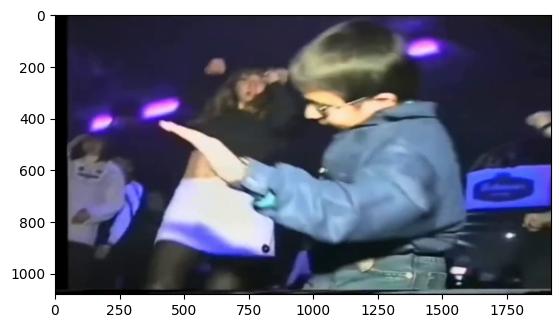

In [2]:
video = mpe.VideoFileClip("boydancing.mp4")

frame = video.get_frame(3)

plt.imshow(frame)

**3 -** Exiba o histograma RGB do frame selecionado.

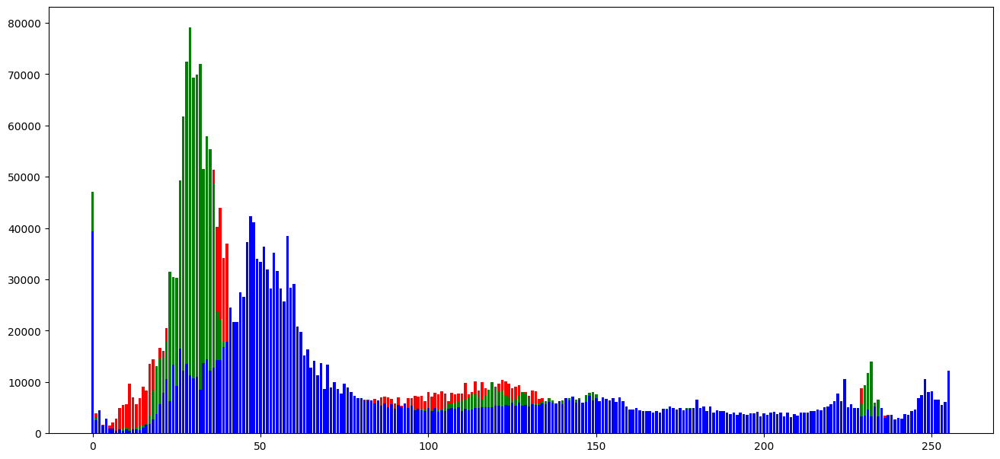

In [3]:
def histogram_gray(img):
    (l, c) = img.shape
    # Histograma com 1 linha e 256 colunas, preenchido com 0.
    histogram = np.zeros(256, dtype=np.int32)

    for i in range(l):
        for j in range(c):
            # Normalizar intensidade do pixel 
            intensity = img[i, j]
            # Incrementar de 1 a quantidade de pixels no histograma,
            # utilizando a intensidade como índice.
            histogram[intensity] += 1
            
    return histogram

def show_histogram(img):
    histogram_r = histogram_gray(img[:, :, 0])
    histogram_g = histogram_gray(img[:, :, 1])
    histogram_b = histogram_gray(img[:, :, 2])
    
    plt.figure(figsize=(16, 16))
    plt.subplot(2, 1, 1)
    plt.bar(range(256), histogram_r, color='red')
    plt.bar(range(256), histogram_g, color='green')
    plt.bar(range(256), histogram_b, color='blue')
    
show_histogram(frame)

**4 -** Crie uma função que receba um frame e retorne um frame em binário com **treshold de 130**, aplique essa função no vídeo e observe o resultado. **Sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [4]:
def frame_binario(frame): 
    # Extrai as dimensões do frame (l = altura, c = largura, p = canais de cor)
    (l, c, p) = frame.shape
    
    # Calcula a imagem em preto e branco média
    frame_bw = np.average(frame, axis=2).astype(np.float64)
    
    # Cria uma imagem binária baseada no limiar 130
    frame_bin = np.zeros(shape=(l, c), dtype=np.uint8)
    frame_bin[frame_bw > 130] = 255
    
    # Cria um novo frame de 3 canais (RGB) com a imagem binária
    frame_3p = np.zeros(shape=(l, c, p), dtype=np.uint8)
    frame_3p[:, :, 0] = frame_bin
    frame_3p[:, :, 1] = frame_bin
    frame_3p[:, :, 2] = frame_bin
    
    return frame_3p
video_bin = video.fl_image(frame_binario)

video_bin.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**5 -** Crie uma função que receba um frame e realize a detecção de bordas nele com **treshold de valor 12**, aplique essa função no vídeo e observe o resultado. **Sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [5]:
def deteccao_bordas(frame):
    # Obtém as dimensões do quadro de entrada
    (l, c, p) = frame.shape  # l -> linhas, c -> colunas, p -> canais (assumindo RGB)

    # Converte o quadro para escala de cinza
    frame_bw = np.average(frame, axis=2).astype(np.float64)

    # Calcula as diferenças absolutas nas direções vertical e horizontal
    abs_diff_c = np.abs(np.diff(frame_bw.astype(np.float64), axis=0, append=255))
    abs_diff_l = np.abs(np.diff(frame_bw.astype(np.float64), axis=1, append=255))

    # Combina as diferenças para obter o gradiente de magnitude
    abs_gradient = np.sqrt(abs_diff_c ** 2 + abs_diff_l ** 2)

    # Aplica um limiar no gradiente de magnitude para detectar bordas
    threshold = 12
    frame_border = np.zeros(shape=(l, c), dtype=np.uint8)
    frame_border[abs_gradient > threshold] = 255
    
    # Cria um quadro de 3 canais com as bordas detectadas
    frame_3p = np.zeros(shape=(l, c, p), dtype=np.uint8)
    frame_3p[:, :, 0] = frame_border
    frame_3p[:, :, 1] = frame_border
    frame_3p[:, :, 2] = frame_border
    
    return frame_3p

video_border = video.fl_image(deteccao_bordas)

video_border.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**6 -** Crie uma função que receba um frame e retorne um frame refletido em relação ao eixo x, aplique essa função no vídeo e observe o resultado. 

In [6]:
def reflect_x(frame):
    # Cria uma matriz de zeros do mesmo formato que o quadro de entrada
    img_refl = np.zeros(shape=frame.shape, dtype=np.uint8)
    
    # Realiza a reflexão vertical invertendo a ordem das linhas (eixo y) e mantendo a ordem das colunas (eixo x)
    img_refl[::-1, ::1] = frame
    
    # Retorna a imagem refletida
    return img_refl

video_cmy = video.fl_image(reflect_x)

video_cmy.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**7 -** Separe o vídeo original em 3 subclips:
- Segundos 0 ao 2: Aplicar conversão para binário
- Segundos 2 ao 4: Aplicar reflexão no eixo x
- Segundos 4 em diante: Aplicar detecção de borda

**Una esses clips em um único vídeo e exiba o resultado.**

In [7]:
# Aplicar conversão para binário
part1 = video.subclip(0,2).fl_image(frame_binario)

# Aplicar reflexão no eixo x
part2 = video.subclip(2,4).fl_image(relect_x)

# Aplicar detecção de borda
part3 = video.subclip(4).fl_image(deteccao_bordas)

# Concatenar ambas partes para gerar um único vídeo
parts = mpe.concatenate_videoclips([part1, part2, part3])
parts.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**8 -** Salve o vídeo resultante da última etapa com o nome "resultado.mp4".

In [9]:
parts.write_videofile('resultado.mp4')

Moviepy - Building video resultado.mp4.
MoviePy - Writing audio in resultadoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video resultado.mp4



Moviepy - Done !
Moviepy - video ready resultado.mp4
